In [77]:
from PIL import Image
from skimage import measure
from skimage import color
import numpy as np 
import pandas as pd 
import os
import cv2
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.patches as mpatches
import pickle
from sklearn.neighbors import NearestNeighbors
from matplotlib.collections import LineCollection
from sklearn.metrics.pairwise import euclidean_distances
from mpl_toolkits.axes_grid1.anchored_artists import AnchoredSizeBar
import matplotlib.font_manager as fm
fontprops = fm.FontProperties(size=34)

Image_folder = 'Y:\coskun-lab\Thomas\Mayar-Data\Image'
Mask_folder = 'Y:\coskun-lab\Thomas\Mayar-Data\Mask'
Cluster_folder = 'Y:\coskun-lab\Thomas\Mayar-Data\Clusters'

sns.set(font_scale=2)
%matplotlib inline

In [78]:
# Experiment
experiments = ['DT14', 'DT15', 'NT2L', 'NT2R']

experiment = experiments[3]

data = None
markers = []
masks = []

DEFAULT_CHANNELS = (1,2)

RGB_MAP = {
    1: {
        'rgb': np.array([207, 0, 214]),
        'range': [0, 255]
    },
    2: {
        'rgb': np.array([0,255,0]),
        'range': [0, 255]
    }
}

def convert_to_rgb(t, channels=DEFAULT_CHANNELS, vmax=255, rgb_map=RGB_MAP):
    """
    Converts and returns the image data as RGB image
    Parameters
    ----------
    t : np.ndarray
        original image data
    channels : list of int
        channels to include
    vmax : int
        the max value used for scaling
    rgb_map : dict
        the color mapping for each channel
        See rxrx.io.RGB_MAP to see what the defaults are.
    Returns
    -------
    np.ndarray the image data of the site as RGB channels
    """
    dim1,dim2,_ = t.shape
    colored_channels = []
    for i, channel in enumerate(channels):
        x = (t[:, :, channel-1] / vmax) / \
            ((rgb_map[channel]['range'][1] - rgb_map[channel]['range'][0]) / 255) + \
            rgb_map[channel]['range'][0] / 255
        x = np.where(x > 1., 1., x)
        x_rgb = np.array(
            np.outer(x, rgb_map[channel]['rgb']).reshape(dim1,dim2, 3),
            dtype=int)
        colored_channels.append(x_rgb)
    im = np.array(np.array(colored_channels).sum(axis=0), dtype=int)
    im = np.where(im > 255, 255, im)
    im = im.astype(np.uint8)
    return im

In [79]:
# Read cluster info
path = os.path.join(Cluster_folder, experiment, "distance.pkl")

f = open(path,"rb")
info = pickle.load(f)
f.close()
markers = info['markers']
marker2number = dict([(name,i) for i,name in enumerate(markers)])
inter_marker = info['inter_marker']

for (dirpath, dirnames, filenames) in os.walk(Image_folder):
    for name in filenames:
        if 'tiff' in name and experiment in name:
            img = cv2.imread(os.path.join(dirpath,name),0)
            data = np.concatenate((data, img[:,:,None]), axis=2) if data is not None else img[:,:,None]
            
masks = []

for (dirpath, dirnames, filenames) in os.walk(Mask_folder):
    for name in filenames:
        if 'BM' in name and experiment in name:        
            img = cv2.imread(os.path.join(dirpath,name),0)
            
            masks.append(img)

# Read cell mask image 
for (dirpath, dirnames, filenames) in os.walk(Mask_folder):
    for name in filenames:
        if 'Cell_Mask' in name and experiment in name:
            cell_mask = np.array(Image.open(os.path.join(dirpath,name)))
            
# Cell centroid
cc_per_marker = {}
for i in range(len(masks)):
# Apply cluster mask 
    res = cv2.bitwise_and(cell_mask,cell_mask,mask = masks[i])
    prop = measure.regionprops_table(res, properties = ['centroid', 'area'])
    # Read points location
    cc_per_marker[i] = np.vstack((prop['centroid-0'], prop['centroid-1'])).T

In [80]:
def plot_interaction(m1,m2, data):
    overlay_img = data[:,:,[marker2number[m1], marker2number[m2]]]
    img_rgb = color.rgb2gray(convert_to_rgb(overlay_img))

    # Nearest neighbors distance

    n = 3
    neigh = NearestNeighbors(n_neighbors=n)

    X = cc_per_marker[marker2number[m1]]
    Y = cc_per_marker[marker2number[m2]]
    y1, x1 = X.T
    y2, x2 = Y.T

    # fit the NN 
    neigh.fit(Y)
    neighbors = neigh.kneighbors(X,return_distance=False)

    # Get the n neirest neighbors position per cell
    n_distance = Y[neighbors]

    fig, ax = plt.subplots(2,1, figsize=(20,26), squeeze = True, gridspec_kw={'height_ratios': [4.2, 1], 'hspace': 0, 'wspace': 0})
 
    # Plot scatter overlaying image
    ax[0].axis('off')
    ax[0].imshow(img_rgb, cmap=plt.get_cmap('gray'), alpha = 0.8, origin='lower')
    ax[0].scatter(x2, y2, color=tuple(RGB_MAP[2]['rgb']/255), label = m2, s=15, alpha=0.6, edgecolors='none')
    ax[0].scatter(x1, y1, color=tuple(RGB_MAP[1]['rgb']/255), label = m1, s=20, alpha=0.6, edgecolors='none')
    ax[0].invert_yaxis()
    # ax[0].set_facecolor((1.0, 0.47, 0.42))
    ax[0].legend(loc=3, markerscale = 3.0, fontsize=25)
    
    # Add scale bar
    scalebar = AnchoredSizeBar(ax[0].transData,
                           200, r'$200  \mu m$', 'lower right', 
                           pad=0.1,
                           color='white',
                           frameon=False,
                           size_vertical=3,
                           fontproperties=fontprops)

    ax[0].add_artist(scalebar)

    distances = []

    for i, ele in enumerate(X):
        for cell in n_distance[i]:
            y, x = np.array([ele,cell]).T.tolist()
            ax[0].plot(x, y,'b-',color="blue", alpha=0.6)
            distances.append(np.linalg.norm(ele-cell))

    ax[0].set_title('Spatial proximity plot: {}\{}'.format(m1,m2), fontsize=30)
    
    bins = [i*2 for i in range(30)]
    distance = pd.Series(distances, name='Distance')
    sns.distplot(distance, bins=bins, kde=False,ax=ax[1],hist_kws={"alpha": 1, "color": "r"},norm_hist=True);
    plt.xlim(0, 60)
    plt.savefig(experiment + '_' + m1+m2+'.png',bbox_inches='tight')


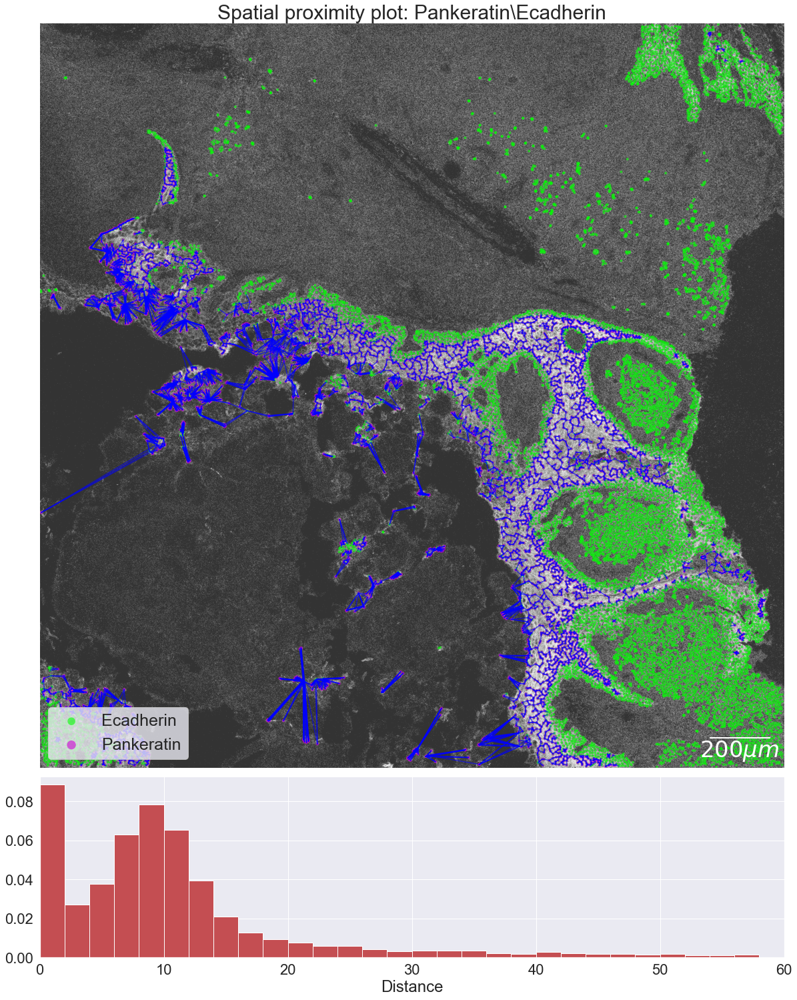

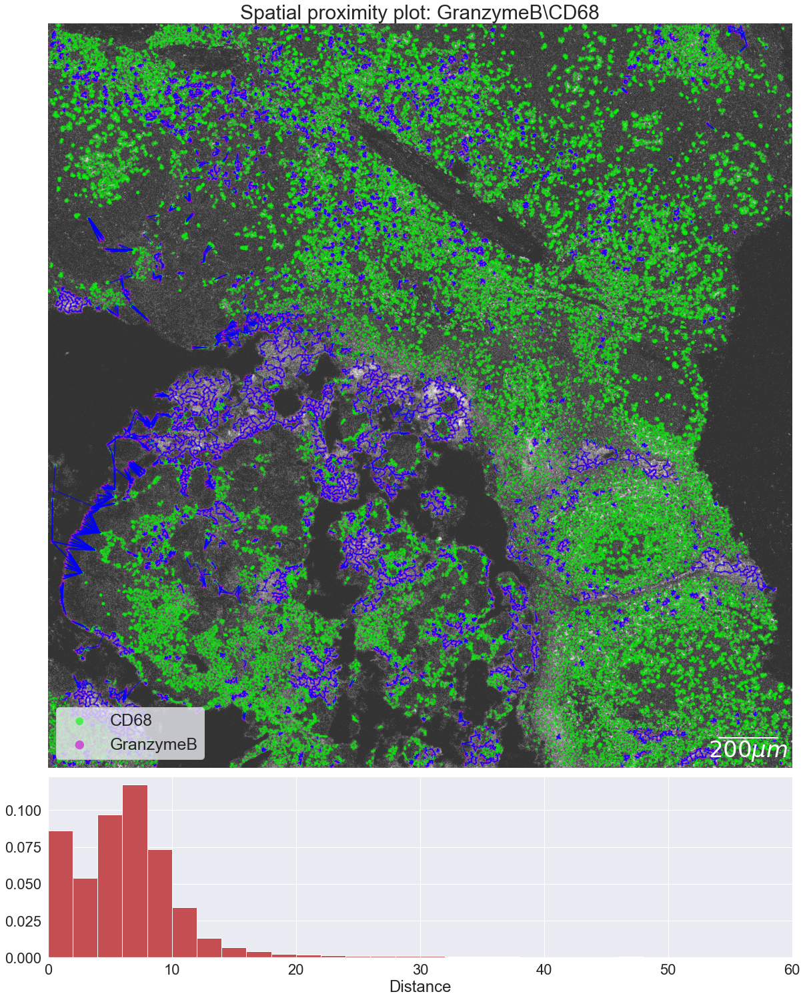

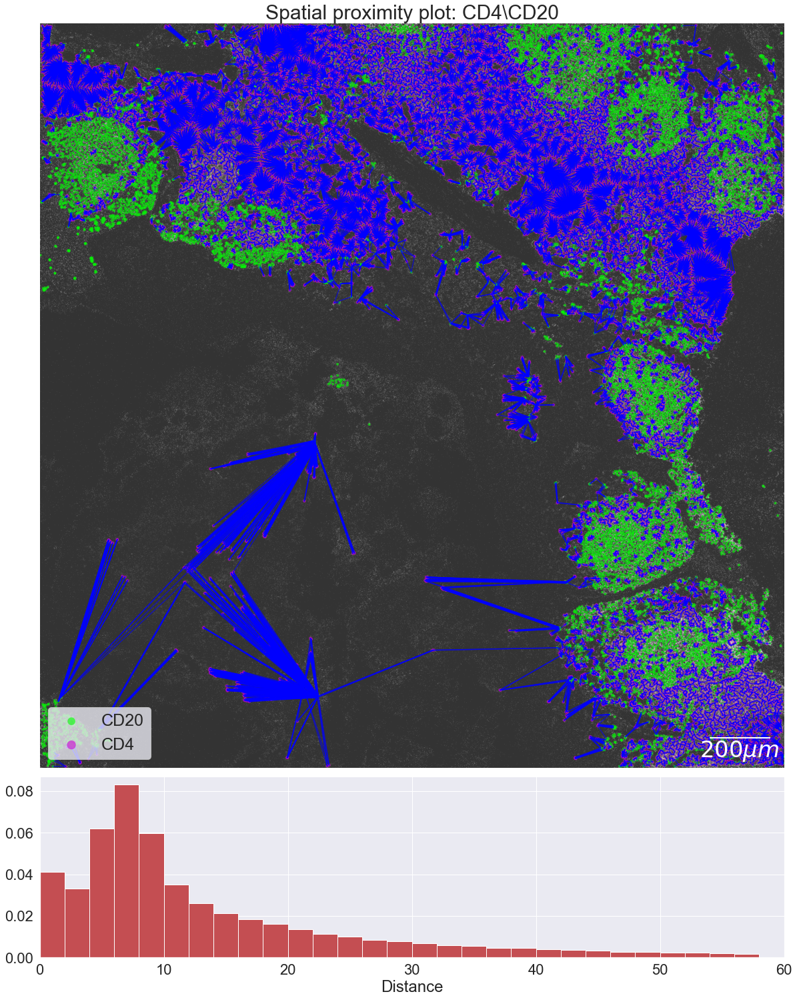

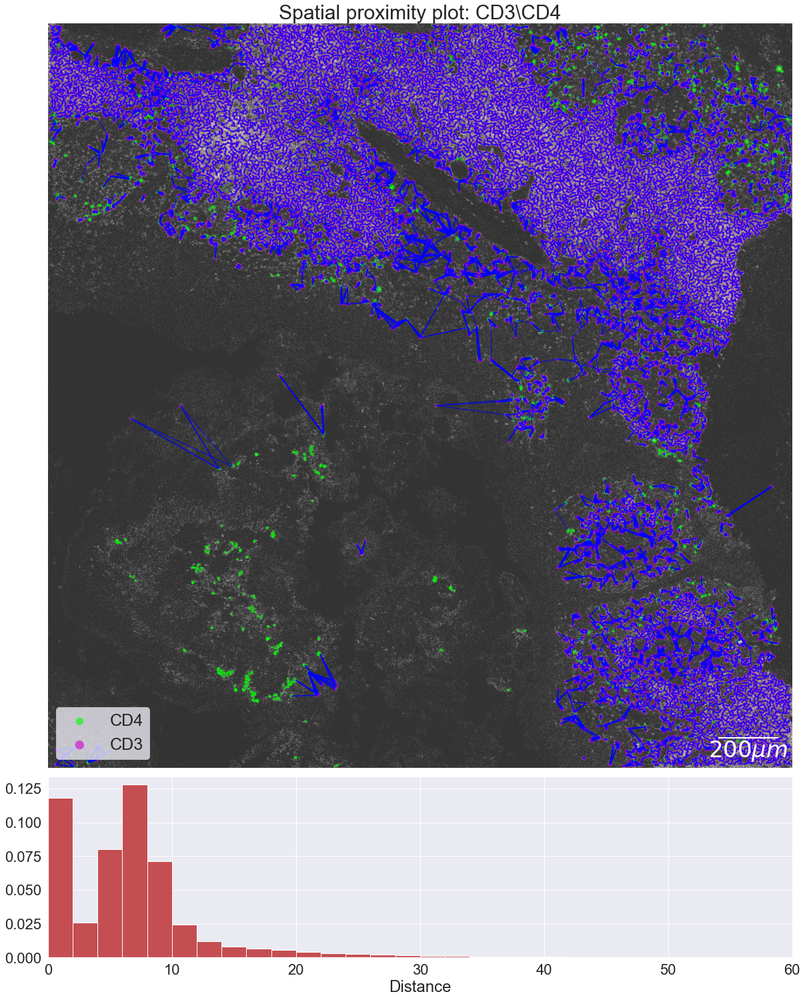

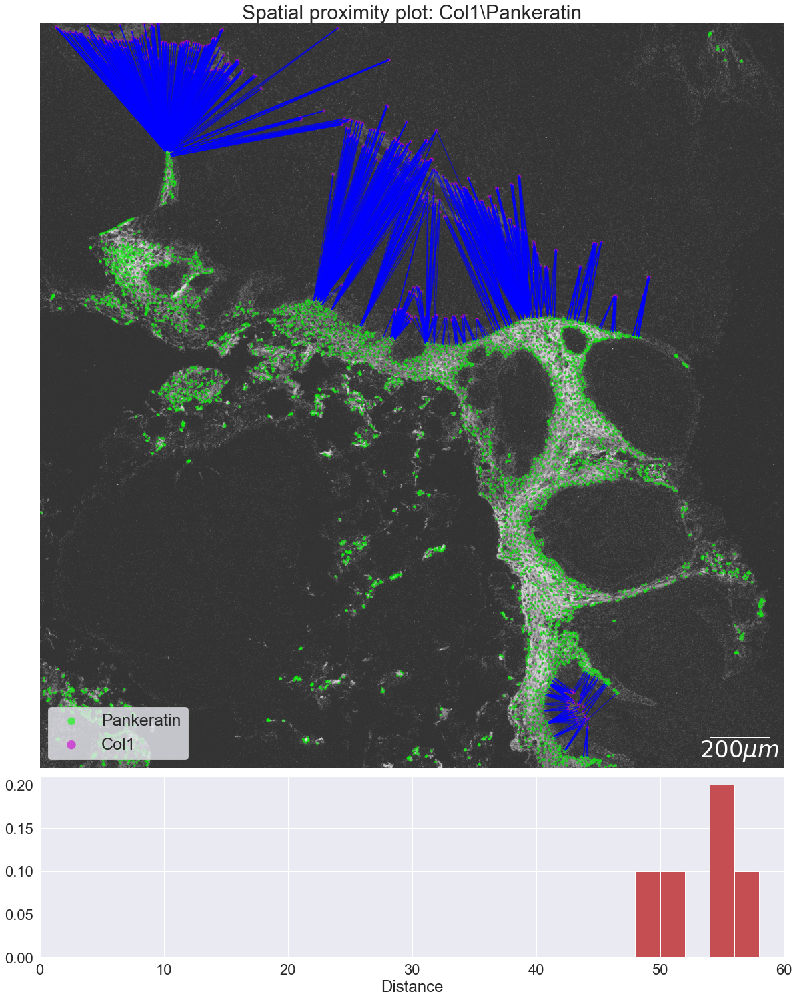

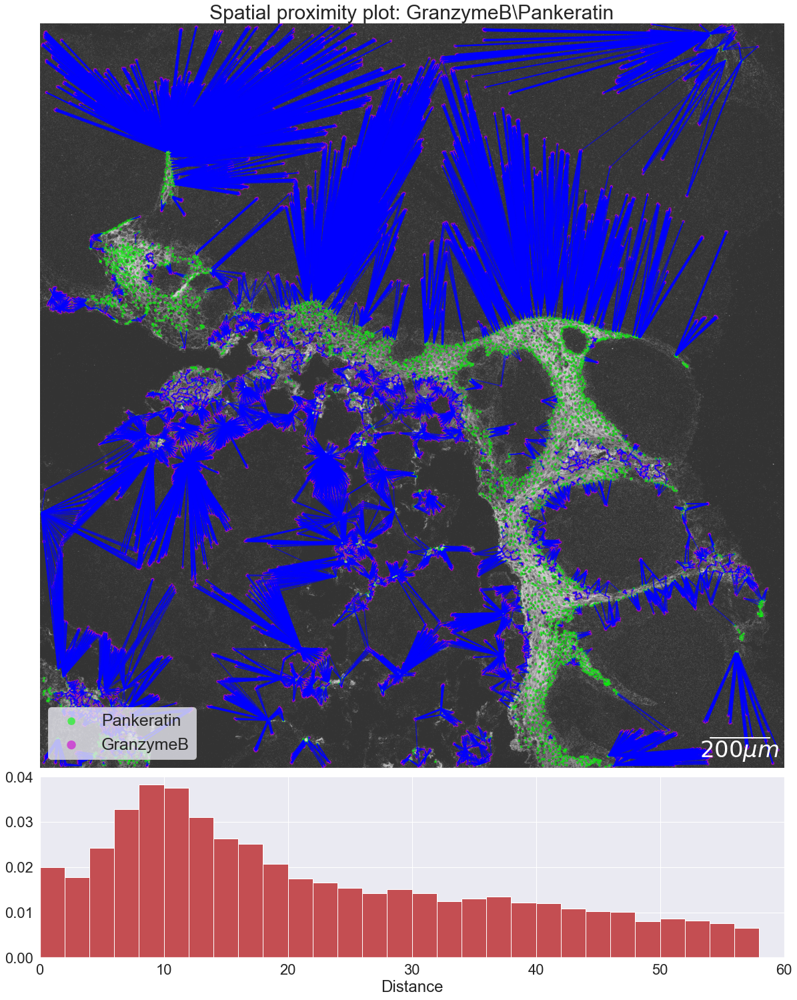

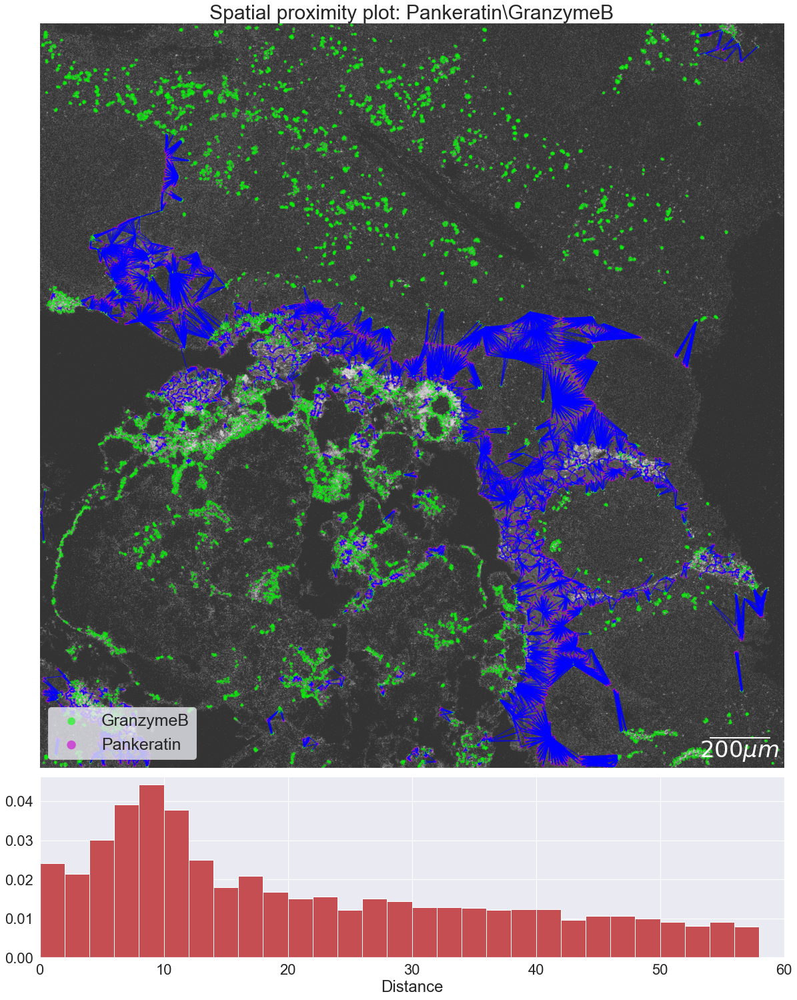

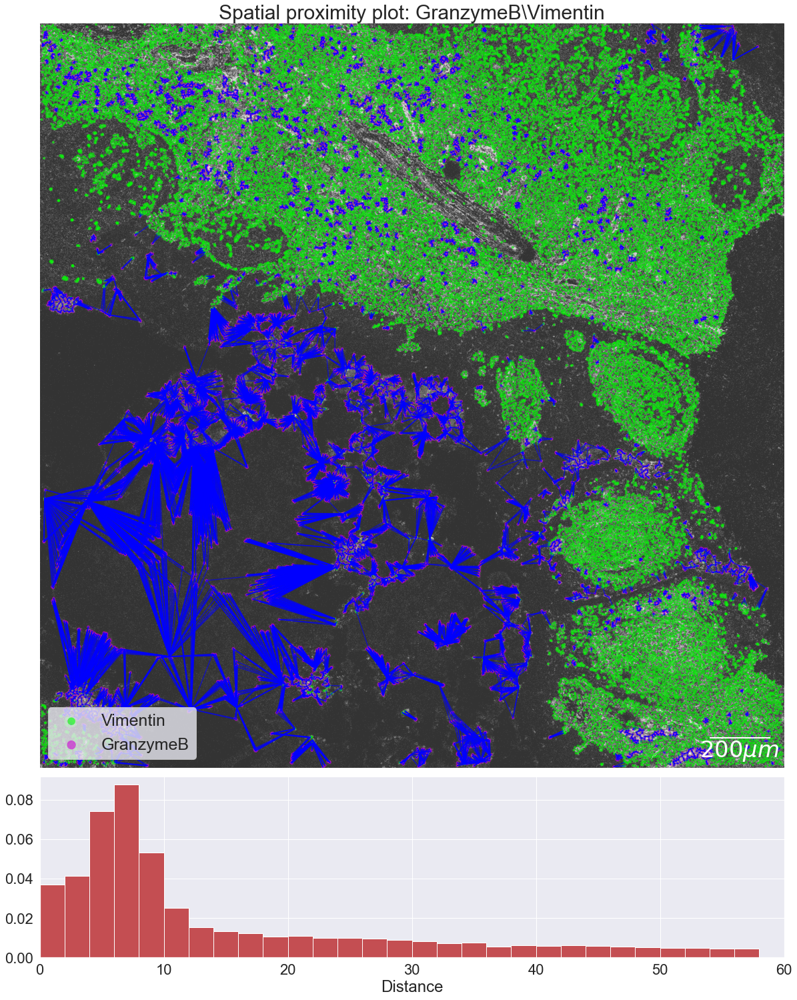

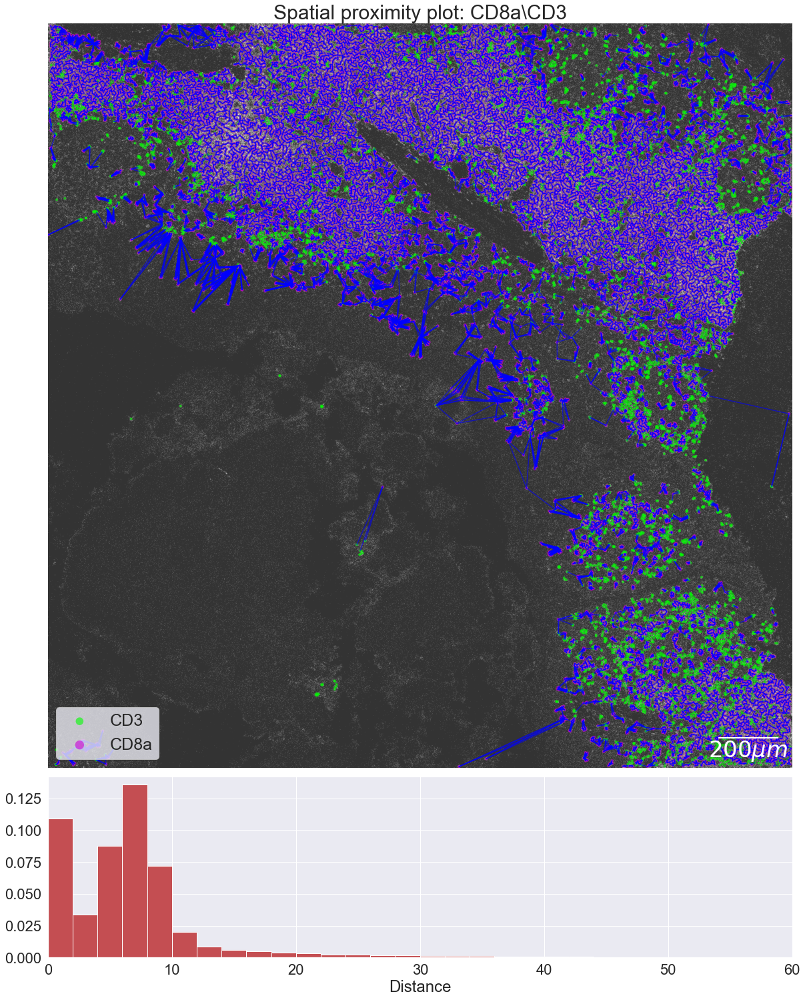

In [81]:
# plot_interaction('PanKeratin','GranzymeB')
# plot_interaction('Col1','PanKeratin')
# plot_interaction('GranzymeB','PanKeratin')
# plot_interaction('GranzymeB','Vimentin')
# plot_interaction('CD8a','CD3')
# plot_interaction('GranzymeB','CD68')
# plot_interaction('PanKeratin','ECadherin')
# plot_interaction('CD4','CD20')
# plot_interaction('CD3','CD4')


plot_interaction('Pankeratin','Ecadherin', data)
plot_interaction('GranzymeB','CD68', data)
plot_interaction('CD4','CD20', data)
plot_interaction('CD3','CD4', data)
plot_interaction('Col1','Pankeratin', data)
plot_interaction('GranzymeB','Pankeratin', data)
plot_interaction('Pankeratin','GranzymeB', data)
plot_interaction('GranzymeB','Vimentin', data)
plot_interaction('CD8a','CD3', data)

In [82]:
# experiments = ['NT1 ROI004', 'NT1 ROI005', 'NT2 ROI003','NT2 ROI004', 'ROI005 Area 1', 'ROI006 Area 2', 'ROI007 Area 1', 'ROI008 Area 2']

# for experiment in experiments:
#     data = None
#     markers = []
#     masks = []
    
#     # Read cluster info
#     path = os.path.join(Cluster_folder, experiment, "distance.pkl")

#     f = open(path,"rb")
#     info = pickle.load(f)
#     f.close()
#     markers = info['markers']
#     marker2number = dict([(name,i) for i,name in enumerate(markers)])
#     inter_marker = info['inter_marker']

#     for (dirpath, dirnames, filenames) in os.walk(Image_folder):
#         for name in filenames:
#             if 'tiff' in name and experiment in name:
#                 img = cv2.imread(os.path.join(dirpath,name),0)
#                 data = np.concatenate((data, img[:,:,None]), axis=2) if data is not None else img[:,:,None]

#     masks = []

#     for (dirpath, dirnames, filenames) in os.walk(Mask_folder):
#         for name in filenames:
#             if 'BM' in name and experiment in name:        
#                 img = cv2.imread(os.path.join(dirpath,name),0)

#                 masks.append(img)

#     # Read cell mask image 
#     for (dirpath, dirnames, filenames) in os.walk(Mask_folder):
#         for name in filenames:
#             if 'Cell_Mask' in name and experiment in name:
#                 cell_mask = np.array(Image.open(os.path.join(dirpath,name)))

#     # Cell centroid
#     cc_per_marker = {}
#     for i in range(len(masks)):
#     # Apply cluster mask 
#         res = cv2.bitwise_and(cell_mask,cell_mask,mask = masks[i])
#         prop = measure.regionprops_table(res, properties = ['centroid', 'area'])
#         # Read points location
#         cc_per_marker[i] = np.vstack((prop['centroid-0'], prop['centroid-1'])).T
        
#     try:
#         plot_interaction('PanKeratin','GranzymeB', data)
#         plot_interaction('Col1','PanKeratin', data)
#         plot_interaction('GranzymeB','PanKeratin', data)
#         plot_interaction('GranzymeB','Vimentin', data)
#         plot_interaction('CD8a','CD3', data)
#         plot_interaction('GranzymeB','CD68', data)
#         plot_interaction('PanKeratin','ECadherin', data)
#         plot_interaction('CD4','CD20', data)
#         plot_interaction('CD3','CD4', data)
#     except:
#         print(experiment)